In [12]:
%matplotlib inline

import cv2
import matplotlib.pyplot as plt
import numpy as np
import math
from scipy.signal import convolve2d


#plt.rcParams['figure.figsize'] = (12, 9)



In [ ]:
!ffmpeg -i pano2.mov -c copy -movflags +faststart repaired.mp4

In [ ]:
!apt update && apt install -y ffmpeg
!pip install opencv-python-headless --upgrade

In [13]:
import glob   #deprecated video attempt
print(glob.glob("frames/"))

import cv2
video_path = "drive/MyDrive/stabilizedBled.mp4"
cap = cv2.VideoCapture(video_path)

if not cap.isOpened():
    print("Error: Could not open video. Possible issues:")
    print("- Corrupted file | Unsupported codec | Wrong path")
else:
    print("Video opened successfully!")
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    print(f"Total frames: {total_frames}")
    cap.release()

['frames/']
Error: Could not open video. Possible issues:
- Corrupted file | Unsupported codec | Wrong path


In [15]:
import cv2
import os

video_path = "drive/MyDrive/stabilizedBled.mp4"
output_folder = "frames/"
os.makedirs(output_folder, exist_ok=True)

cap2 = cv2.VideoCapture(video_path)
frame_count = 0

frameskip = 3

while cap2.isOpened():
    ret, frame = cap2.read()
    if not ret:
        break
    if frame_count % frameskip == 0:  # Adjust how many frames are in between each selected frame
        cv2.imwrite(f"{output_folder}frame_{frame_count:04d}.jpg", frame)
    frame_count += 1
cap2.release()

In [16]:
import numpy as np
from collections import defaultdict

match_thresh = 0.85 #what percent of matches to accept (.85 means only the 85% most confident matches)

akaz = cv2.AKAZE_create() #using akaze bc sift but faster and more even
image_paths = sorted([f"{output_folder}{f}" for f in os.listdir(output_folder) if f.endswith(".jpg")])
features = {}

# Extracting features for all images
j = 0
for path in image_paths:
    img = cv2.imread(path, 0)
    kp, desc = akaz.detectAndCompute(img, None)
    features[path] = {'kp': kp, 'desc': desc}

    if j == 12:  #code to grab points for images 12 and 13 for manual testing
      kps1 = kp
    if j == 13:
      kps2 = kp

    j += 1





In [17]:
matches_dict = defaultdict(list)
bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)

offset = 3 #number of frames between the frames youre comparing

for k in range(len(image_paths) - offset):    # Matching features between consecutive frames
    path1, path2 = image_paths[k], image_paths[k+offset]
    desc1, desc2 = features[path1]['desc'], features[path2]['desc']
    matches = bf.match(desc1, desc2)

    matches_dict[(path1, path2)] = sorted(matches, key=lambda x: x.distance)

    good_length = int(len(matches_dict[(path1, path2)])*match_thresh)
    matches_dict[(path1, path2)] = matches_dict[(path1, path2)][:good_length]

    if k == 12:
      m12 = matches_dict[(path1, path2)]  # grabbing matches between images 12 and 13 for manual testing

301
404


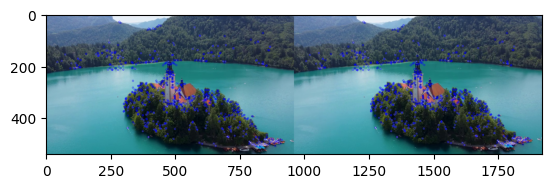

In [18]:
print(len(image_paths))   #cell for checking if matching works and is fairly even
im12_path = image_paths[12]
im13_path = image_paths[13]

im12 = cv2.imread(im12_path)
im13 = cv2.imread(im13_path)
print(len(m12))
match_img = cv2.drawMatches(im12, kps1, im13, kps2, m12[600:], None, matchColor=(0,255,0), singlePointColor=(255,0,0))
plt.imshow(cv2.cvtColor(match_img, cv2.COLOR_BGR2RGB))
plt.show()

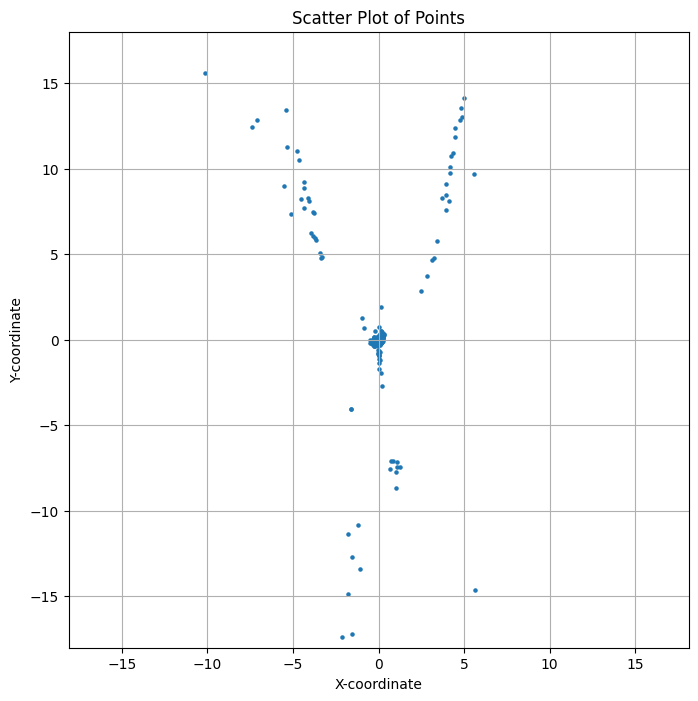

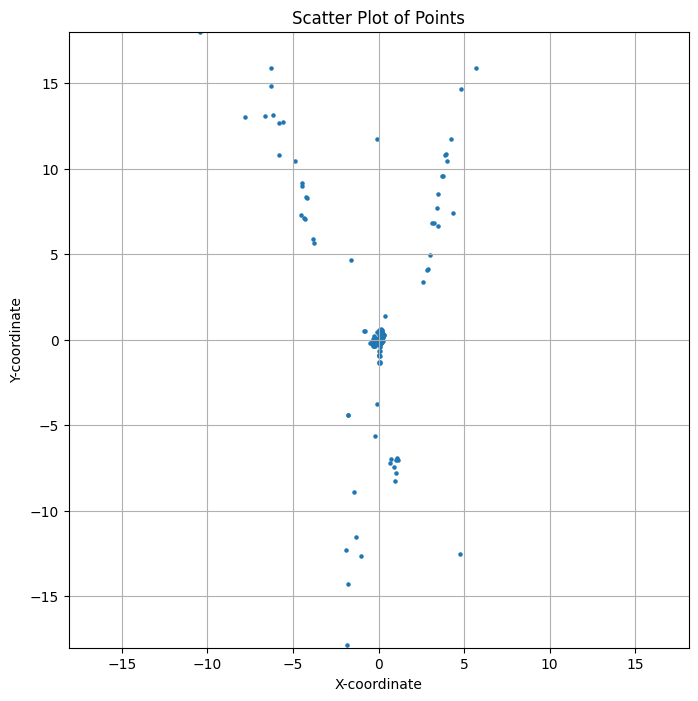

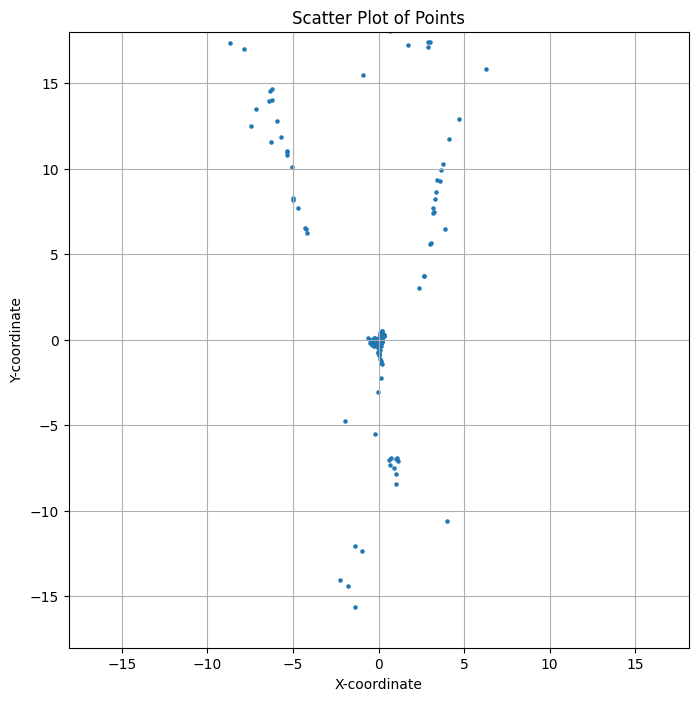

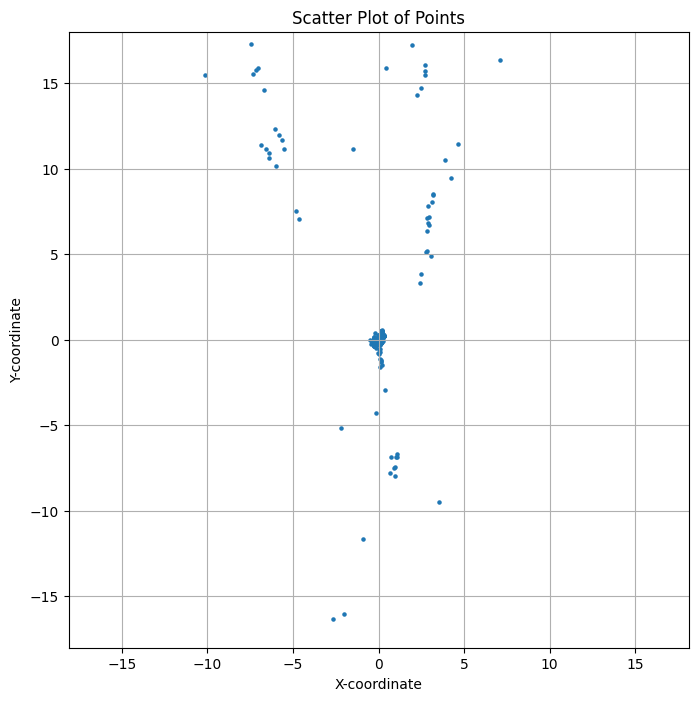

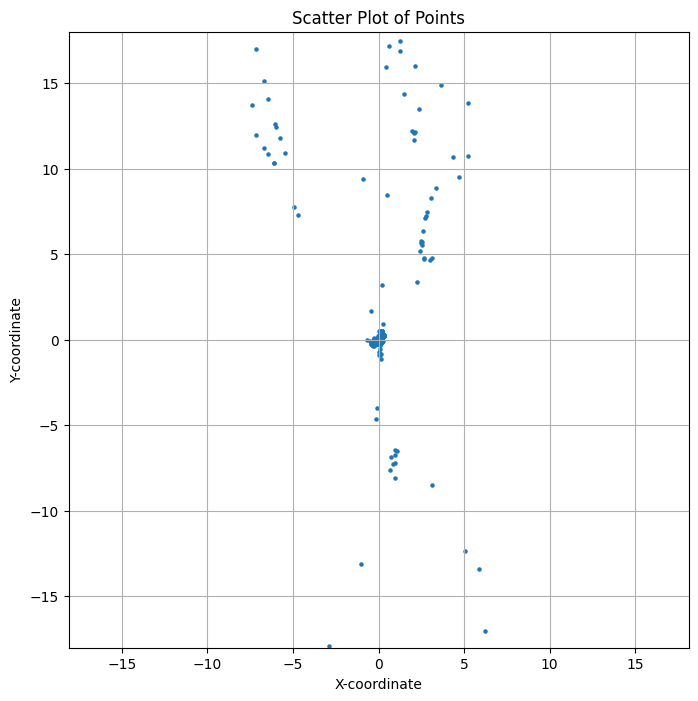

...

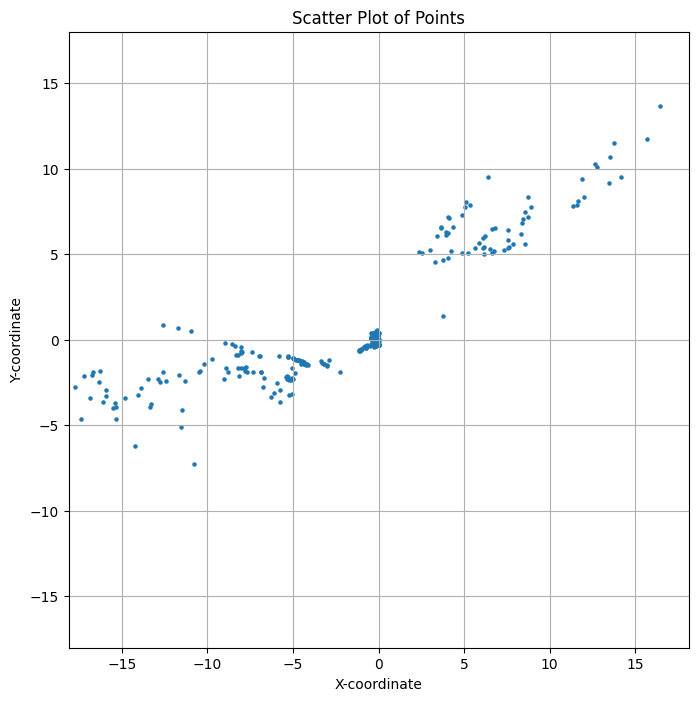

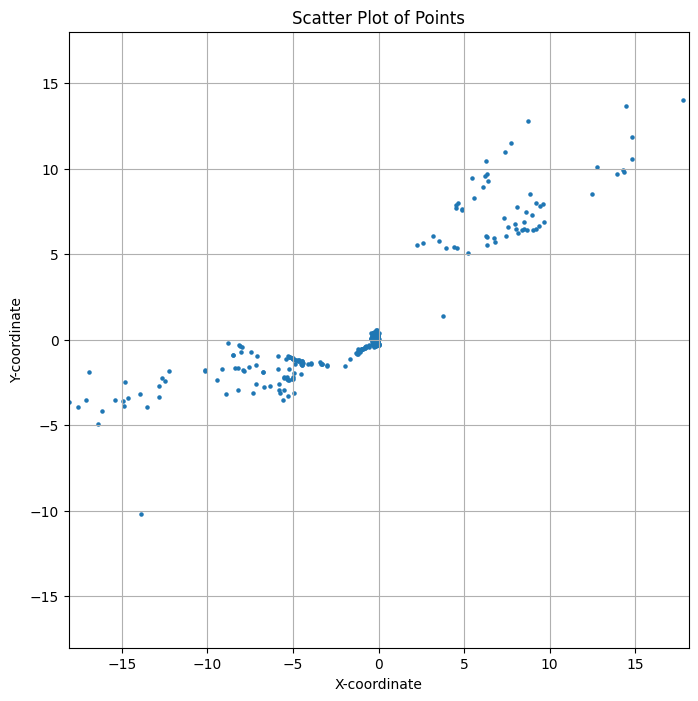

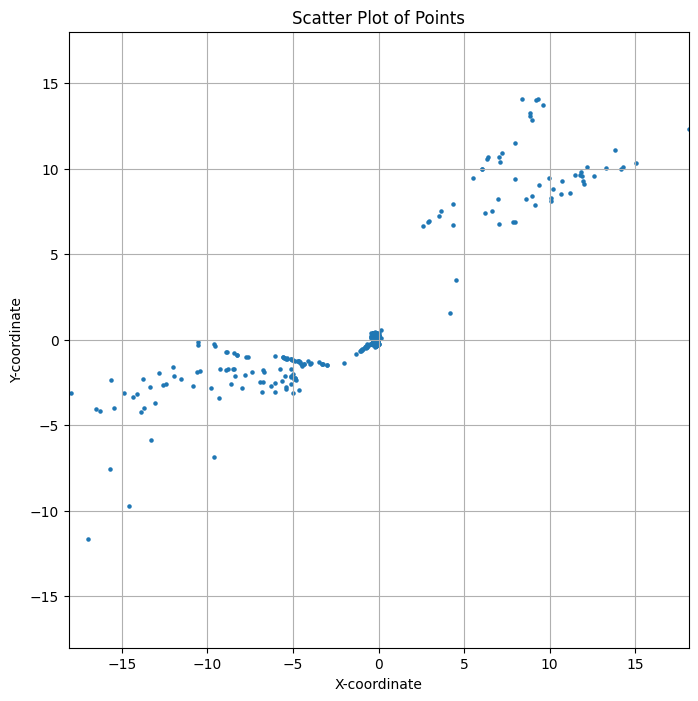

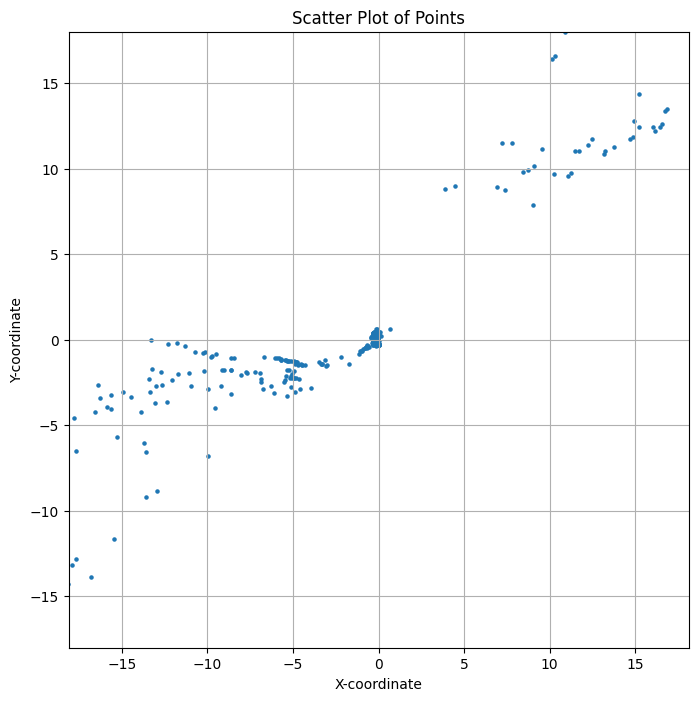

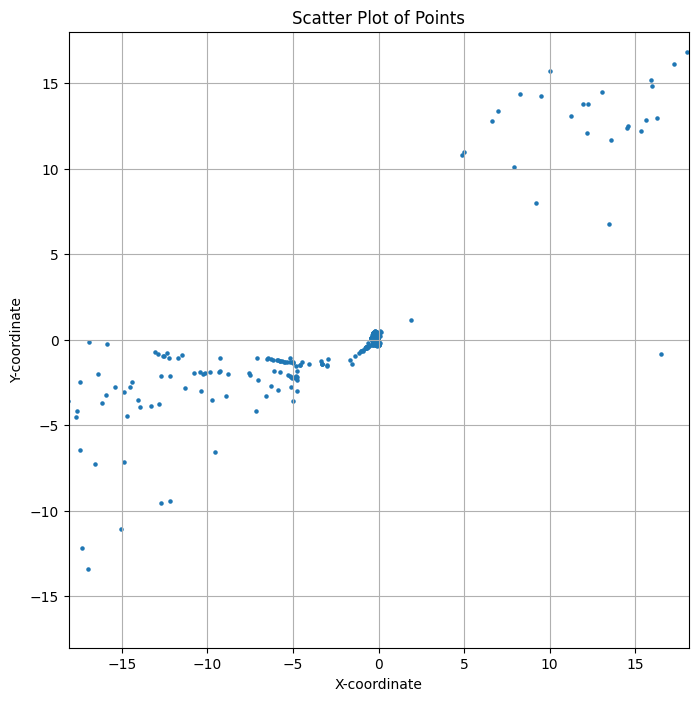

In [57]:
def get_matched_points(features, matches, idx1, idx2):   # helper function: gets pixel coords of features
    kp1, kp2 = features[idx1]['kp'], features[idx2]['kp']
    pts1 = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
    pts2 = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)
    return pts1, pts2


# 625 is the magic number


def locate_Tri(angle1, angle2, xcord, ycord, pixels, fov, elev):  #takes camera angles and pixel locations and triangulates xyz coords

  np.set_printoptions(suppress=True, precision=3)

  # X-Y COORDINATES

  # gets angular offset from center based on pixel location

  focal_pixels = 625 #change to a parameter later?


  #vertOff = (pixels[1] - 2*ycord)/pixels[1] * (fov[1]/2)  old method

  vertOff = np.rad2deg(np.arctan((.5*pixels[1] - ycord) / focal_pixels))

  vertOff += elev

  spread_ratios = np.cos(np.deg2rad(vertOff)).reshape([-1,2])

  #horzOff = ((2*xcord - pixels[0])/pixels[0] * (fov[0]/2))  old method

  horzOff = np.rad2deg(np.arctan((xcord - .5*pixels[0]) / focal_pixels))

  horzOff /= spread_ratios #adjusting for downwards tilt (this gets projection of the angle onto xy plane)



  base = np.array([angle1, angle2]) #starting horizontal angles for both viewpoints (where the center of frame is pointing) (1 by 2)
  al = (90 + base) + horzOff        #est. horizontal angle for all features from both viewpoints (n by 2 matrix)

  alpha = np.tan(np.deg2rad(al[:,0])) # separates and converts from angle into x-y "slopes"
  gamma = np.tan(np.deg2rad(al[:,1])) # alpha is first view, gamma is second  (both n by 1)

  th1 = np.deg2rad(angle1) #getting camera angles again for below calculation
  th2 = np.deg2rad(angle2)
  x = np.stack([alpha, gamma], axis=1) @ (np.array([np.sin(th1), -np.sin(th2)]).reshape(-1,1)) # complicated algebra crammed into one line
  x += np.cos(th1) - np.cos(th2)
  x = x/((alpha-gamma).reshape(-1,1))    # these 3 lines triangulate ang get x coords for all features  (n by 1 vector)

  #x[np.abs(x) > 100] = 10                  #  optional distance thresholding

  y = alpha.reshape(-1,1) * (x - np.sin(th1))
  y -= np.cos(th1)                             # re-solve for y   (n by 1)


  # ELEVATION AND HEIGHT (Z)

  norms1 = np.stack([x,y], axis=1).reshape(-1,2)
  norms1 -= np.array([np.sin(th1), -np.cos(th1)])
  #print(norms1)
  norms1 = np.linalg.norm(norms1, axis=1)            #gets x-y distances of points (1st camera)   (n by 1)

  norms2 = np.stack([x,y], axis=1).reshape(-1,2) - np.array([np.sin(th2), -np.cos(th2)])
  norms2 = np.linalg.norm(norms2, axis=1)            # 2nd camera   (n by 1)

  #print(np.stack([norms1, norms2], axis=1))

  # estimates height from both cameras by multiplying the horizontal distance from each camera by the tangent of the vertical angle gotten earlier
  heights = np.stack([norms1, norms2], axis=1) * np.tan(np.deg2rad(vertOff)).reshape([-1,2]) # (n by 2)
  # print("        L1         ")
  # print(vertOff)
  # print("     L2     ")
  # print(np.tan(np.deg2rad(vertOff)).reshape([-1,2]))
  heights = np.mean(heights, axis=1).reshape([-1,1])   #takes average of both estimates to get final height (n by 1)



  #np.set_printoptions(suppress=True)
  #print(heights.shape, heights)


  points = np.stack([x,y], axis=1)    #checking if the points look right in x-y plane
  plt.figure(figsize=(8, 8))
  plt.scatter(points[:, 0], points[:, 1], s=5) # s is marker size
  plt.xlabel('X-coordinate')
  plt.ylabel('Y-coordinate')
  plt.title('Scatter Plot of Points')
  plt.grid(True)
  plt.axis('equal')
  rang = 18
  plt.xlim(-rang, rang)
  plt.ylim(-rang, rang)
  plt.show()


  pts = np.stack([x,y, heights], axis=1)
  return pts.reshape(-1,3)



# Hyperparameters
elevation = -6  # degrees
n = 300          # amount of photos taken minus 1
ending_gap = 55.5 # amount of degrees away the video was from a complete rotation  (0 for a full orbit)

# ending gap = 21 + 34.65


pointsF = np.zeros((0,3))
for i in range(n + 1 - offset):
  path1, path2 = image_paths[i], image_paths[i+offset]
  pts1, pts2 = get_matched_points(features, matches_dict[(path1, path2)], path1, path2) # gets coords of features
  amount_matches = pts1.shape[0]  # amounts of features

  inc = (360-ending_gap)/n      # angular increment between photos

  xlist = np.zeros((amount_matches, 2))
  ylist = np.zeros((amount_matches, 2))

  for j in range(amount_matches):                  # populates pixel coords of features
    xlist[j] = (pts1[j][0][0], pts2[j][0][0])
    ylist[j] = (pts1[j][0][1], pts2[j][0][1])


  pts3 = locate_Tri(inc * i, inc * (i+offset), xlist, ylist, [960, 540], [75, 47], elevation) # gets xyz coords (n by 3)
  pointsF = np.concatenate((pointsF, pts3), axis=0)

pointsF[:,2] *= 1   # inverts height (dont know why this is needed but it is)


In [58]:
!pip install plotly
import plotly.express as px
import pandas as pd

df = pd.DataFrame(pointsF, columns=['X', 'Y', 'Z']) # converts to pandas

fig = px.scatter_3d(df, x='X', y='Y', z='Z', opacity=0.1)
fig.update_traces(marker_size=2)



plot_range = 7
fig.update_layout(scene = dict(
                    zaxis = dict(range=[-plot_range, plot_range],),
                    yaxis = dict(range=[-plot_range, plot_range],),
                    xaxis = dict(range=[-plot_range, plot_range],),
                    aspectmode='cube', # cube aspect ratio
                    aspectratio=dict(x=1, y=1, z=1) # Compress along any axis by increasing the number
                    ))

fig.show()

In [ ]:
# LLM attempt because I was curious if it could do it
# (fails because the AI doesn't grasp that you need to rotate the set of points in space to account for the drone movement between shots)
# (also doesnt triangulate properly lol)
# It does however create a cool galaxy-like shape that aligns into the original image from the right angle so i kept it



def get_matched_points(features, matches, idx1, idx2):
    kp1, kp2 = features[idx1]['kp'], features[idx2]['kp']
    pts1 = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
    pts2 = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)
    return pts1, pts2
#print(pts3D.shape, pts3D)
ptstotal = np.zeros((1,3))
for i in range(len(image_paths) - 1):
  # Initialize with first two frames
  path1, path2 = image_paths[i], image_paths[i+1]
  pts1, pts2 = get_matched_points(features, matches_dict[(path1, path2)], path1, path2)
  print(pts1)

  # Assume camera intrinsics (focal length, principal point)
  K = np.array([[1000, 0, 960], [0, 1000, 540], [0, 0, 1]])  # Adjust based on your camera

  # Essential matrix and pose recovery
  E, mask = cv2.findEssentialMat(pts1, pts2, K, method=cv2.RANSAC, prob=0.999, threshold=1.0)
  _, R, t, mask = cv2.recoverPose(E, pts1, pts2, K)

  # Triangulate initial 3D points
  P1 = K @ np.hstack((np.eye(3), np.zeros((3, 1))))  # Projection matrix for first camera
  P2 = K @ np.hstack((R, t))

  # Reshape the transposed points to (2, N)
  pts1_T_reshaped = pts1.T.reshape(2, -1)
  pts2_T_reshaped = pts2.T.reshape(2, -1)

  pts4D = cv2.triangulatePoints(P1, P2, pts1_T_reshaped, pts2_T_reshaped)
  pts3D = pts4D[:3] / pts4D[3]  # Convert to non-homogeneous
  if i==0:
    ptstotal = pts3D
  else:
    ptstotal = np.concatenate((ptstotal, pts3D), axis=1)



Streaming output truncated to the last 5000 lines.
 [[833.41956   85.88058 ]]

 [[830.1121    76.5534  ]]

 [[202.1365   171.19917 ]]

 [[598.06854  173.42845 ]]

 [[409.32648  184.03256 ]]

 [[747.4694   159.92346 ]]

 [[454.20355  266.29977 ]]

 [[428.65967  473.73236 ]]

 [[689.56793  170.4395  ]]

 [[511.5122   432.1547  ]]

 [[472.40924  241.69278 ]]

 [[829.31726   75.27321 ]]

 [[141.97673  186.34264 ]]

 [[545.27313  495.12625 ]]

 [[498.83896  446.17978 ]]

 [[165.9646   203.14682 ]]

 [[564.13794  333.53238 ]]

 [[435.18985   88.66031 ]]

 [[598.3152   173.34282 ]]

 [[196.21072  185.94212 ]]

 [[870.00336   96.19328 ]]

 [[846.3822   155.64557 ]]

 [[453.593    265.7604  ]]

 [[472.9404   255.07729 ]]

 [[456.39362  466.48297 ]]

 [[822.9634    64.622375]]

 [[817.5327    63.989315]]

 [[476.41687  266.6844  ]]

 [[459.49066  263.8801  ]]

 [[827.99634   96.02617 ]]

 [[476.98923  267.28513 ]]

 [[451.67316  453.98145 ]]

 [[609.6162   181.47333 ]]

 [[460.41748  261.78387 ]

In [ ]:
!pip install plotly
import plotly.express as px
import pandas as pd

# Convert points to DataFrame
df = pd.DataFrame(ptstotal.T, columns=['X', 'Y', 'Z'])
fig = px.scatter_3d(df, x='X', y='Y', z='Z', opacity=0.2)
fig.update_traces(marker_size=2)

# Example: Setting the bounds for the Z axis
# You can add range_x and range_y similarly
plot_range = 300
fig.update_layout(scene = dict(
                    zaxis = dict(range=[-plot_range*3, plot_range*3],), # Adjust these values as needed
                    yaxis = dict(range=[-plot_range, plot_range],),
                    xaxis = dict(range=[-plot_range, plot_range],),
                    aspectmode='cube', # Add this line to enforce a cubic aspect ratio
                    aspectratio=dict(x=1, y=1, z=1) # Compress along the X axis
                    ))

fig.show()